This is the top of the program

In [1]:
#Importing libraries, and most importantly, TensorFlow

import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import cv2
import tensorflow as tf

from matplotlib import image as mpimg

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image, ImageOps # the pillow image processing modules we will need

In [2]:
import pathlib   #library for getting the filepath

# specify the image directory paths for the data we want to use
allfiles = "C:/Users/maxc2/Desktop/CMP304/Part2 - ML/Assignment/GrayscaleDataset/"

allfiles = pathlib.Path(allfiles)
        

In [ ]:
#This is managing data, creating grayscale copies of images. This should only be run ONCE!
filechosen = "tiny/"
filechosen2 = "othercats/"

augment_location = "C:/Users/maxc2/Desktop/CMP304/Part2 - ML/Assignment/DataImages/" + filechosen2
save_location_oc = "C:/Users/maxc2/Desktop/CMP304/Part2 - ML/Assignment/GrayscaleDataset/othercats/"
save_location_tiny = "C:/Users/maxc2/Desktop/CMP304/Part2 - ML/Assignment/GrayscaleDataset/tiny/"
augment_path = pathlib.Path(augment_location)
files = os.listdir(augment_path)
num = 0

# iterate over files
for file in files:
    num = num + 1
    strnum = str(num)
    #numstring = "tiny" + strnum
    numstring = "othercats" + strnum
    
    # make sure file is an image
    if file.endswith(('.jpg')):
        img_name = file
        this_aug_path = augment_location + file

        # Convert image to grayscale (.jpg) and save
        with Image.open(this_aug_path) as im:
            im_change = im.convert('L')
            im_change.save(save_location_oc + numstring + "_gs.jpg")
            
    elif file.endswith(('.png')):
        img_name = file
        this_aug_path = augment_location + file

        # Convert image to grayscale (.jpg) and save
        with Image.open(this_aug_path) as im:
            im_change = im.convert('L')
            im_change.save(save_location_oc + numstring + "_gs.png")

   

In [3]:
#Loading data and creating a dataset

#Parameters for the datasets
batch_size = 20    #Number of training examples in one "pass"
img_height = 150   #Condense image sizes
img_width = 150

#Setting up the training data set
train_ds = tf.keras.utils.image_dataset_from_directory(
    allfiles,
    validation_split=0.2,
    subset="training",
    seed=123,
    image_size=(img_height, img_width),
    batch_size=batch_size)

#Setting up the validation data set
val_ds = tf.keras.utils.image_dataset_from_directory(
    allfiles,
    validation_split=0.2,
    subset="validation",
    seed=123,
    image_size=(img_height, img_width),
    batch_size=batch_size)

#Assigning the names of the different classes to a variable
class_names = train_ds.class_names
print(class_names)

Found 400 files belonging to 2 classes.
Using 320 files for training.
Found 400 files belonging to 2 classes.
Using 80 files for validation.
['othercats', 'tiny']


In [4]:
#Optimising performance of retrieving data using .cache and .prefetch
AUTOTUNE = tf.data.AUTOTUNE

#Using cache and prefetch, assigning to train and val data sets
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [5]:
num_classes = len(class_names)

#Setting up the augmentation layer to help with overfitting
data_augmentation = tf.keras.Sequential([
  layers.RandomFlip("horizontal_and_vertical", input_shape=(img_height, 
                                                              img_width,
                                                              3)),
  layers.RandomRotation(0.1),
  layers.RandomZoom(0.1)
])


#Setting up the model. This includes normalisation (Rescaling), applying layers and dropout. Output layer of softmax
model = Sequential([
  data_augmentation,
  layers.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  layers.Conv2D(8, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dropout(0.4),
  layers.Dense(num_classes, activation='softmax')   
])

In [6]:
optbefore = 'adam'

#Compiling the model with a preset learning rate of type adam
model.compile(optimizer=optbefore,
              #loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

#Summary of the model
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (None, 150, 150, 3)       0         
                                                                 
 rescaling (Rescaling)       (None, 150, 150, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 150, 150, 8)       224       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 75, 75, 8)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 75, 75, 16)        1168      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 37, 37, 16)       0         
 2D)                                                  

In [7]:
#Running the model, with an epoch count of 20

epochs = 20
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/20
16/16 [==============================] - 3s 90ms/step - loss: 0.7944 - accuracy: 0.4969 - val_loss: 0.6928 - val_accuracy: 0.5375
Epoch 2/20
16/16 [==============================] - 1s 72ms/step - loss: 0.6929 - accuracy: 0.4844 - val_loss: 0.6909 - val_accuracy: 0.5250
Epoch 3/20
16/16 [==============================] - 1s 73ms/step - loss: 0.6917 - accuracy: 0.5250 - val_loss: 0.6881 - val_accuracy: 0.6500
Epoch 4/20
16/16 [==============================] - 1s 72ms/step - loss: 0.6922 - accuracy: 0.5312 - val_loss: 0.6878 - val_accuracy: 0.6750
Epoch 5/20
16/16 [==============================] - 1s 72ms/step - loss: 0.6862 - accuracy: 0.6000 - val_loss: 0.6806 - val_accuracy: 0.6875
Epoch 6/20
16/16 [==============================] - 1s 73ms/step - loss: 0.6755 - accuracy: 0.6094 - val_loss: 0.6627 - val_accuracy: 0.6625
Epoch 7/20
16/16 [==============================] - 1s 73ms/step - loss: 0.6648 - accuracy: 0.6031 - val_loss: 0.6388 - val_accuracy: 0.7000
Epoch 8/20
16

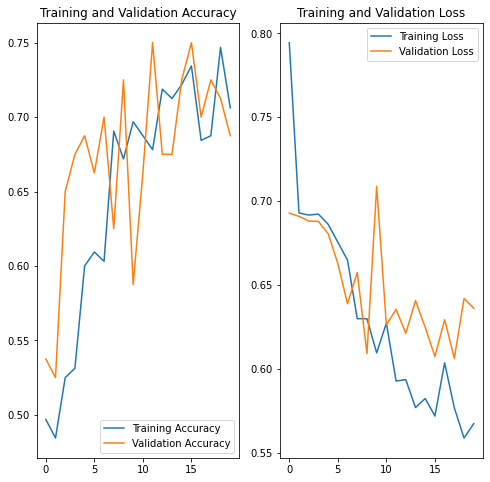

In [8]:
#Plotting the models accuracy and loss on a graph.
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

NOW, we take a look at a new image and predict its class

TESTING ALL IN THE SAME FOLDER

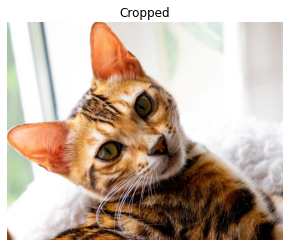

This image most likely belongs to tiny with a 50.06 percent confidence.


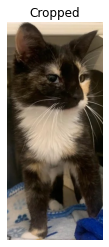

This image most likely belongs to tiny with a 56.34 percent confidence.


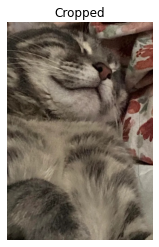

This image most likely belongs to othercats with a 63.86 percent confidence.


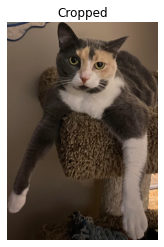

This image most likely belongs to othercats with a 55.41 percent confidence.


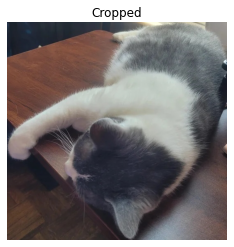

This image most likely belongs to othercats with a 55.96 percent confidence.


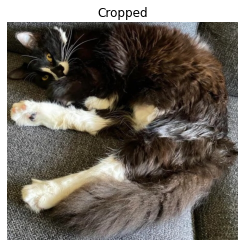

This image most likely belongs to tiny with a 57.75 percent confidence.


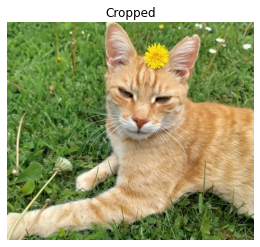

This image most likely belongs to othercats with a 55.22 percent confidence.


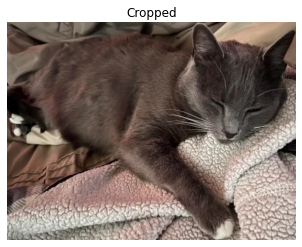

This image most likely belongs to othercats with a 63.85 percent confidence.


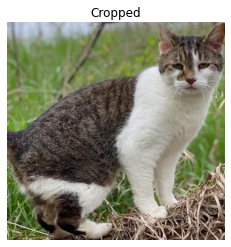

This image most likely belongs to othercats with a 63.83 percent confidence.


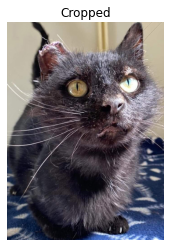

This image most likely belongs to othercats with a 54.16 percent confidence.


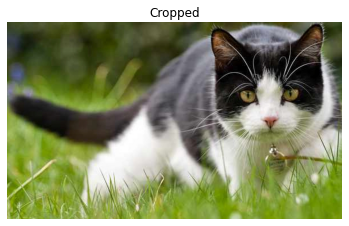

This image most likely belongs to tiny with a 51.21 percent confidence.


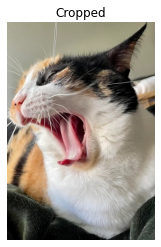

This image most likely belongs to othercats with a 54.63 percent confidence.


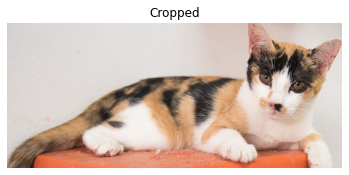

This image most likely belongs to othercats with a 64.86 percent confidence.


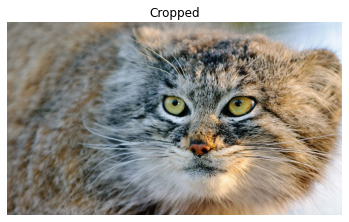

This image most likely belongs to othercats with a 62.46 percent confidence.


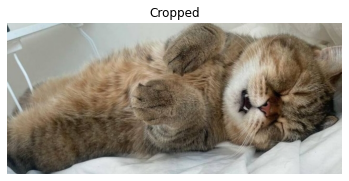

This image most likely belongs to othercats with a 67.47 percent confidence.


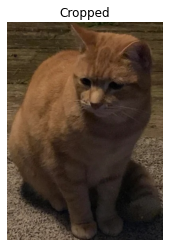

This image most likely belongs to othercats with a 56.26 percent confidence.


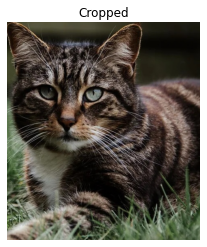

This image most likely belongs to tiny with a 56.84 percent confidence.


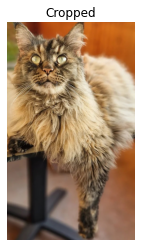

This image most likely belongs to othercats with a 55.81 percent confidence.


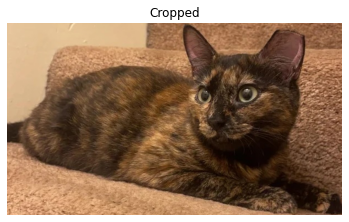

This image most likely belongs to othercats with a 55.66 percent confidence.


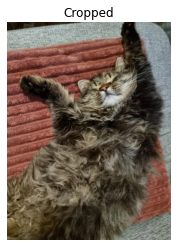

This image most likely belongs to othercats with a 51.84 percent confidence.


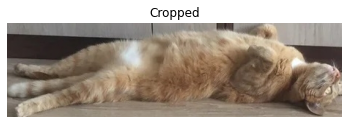

This image most likely belongs to othercats with a 66.24 percent confidence.


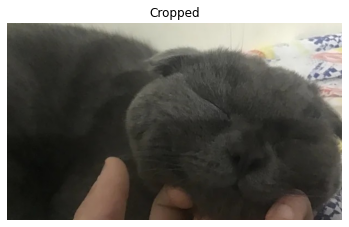

This image most likely belongs to othercats with a 68.88 percent confidence.


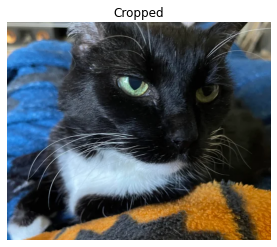

This image most likely belongs to tiny with a 57.68 percent confidence.


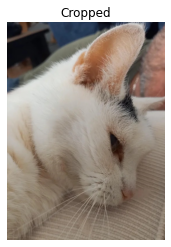

This image most likely belongs to othercats with a 68.86 percent confidence.


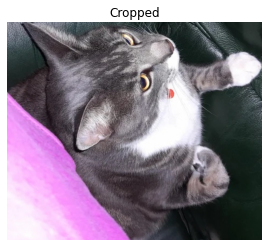

This image most likely belongs to othercats with a 60.95 percent confidence.


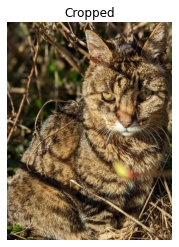

This image most likely belongs to tiny with a 51.17 percent confidence.


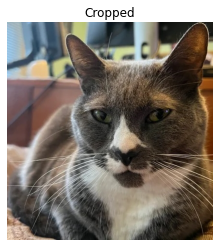

This image most likely belongs to othercats with a 53.58 percent confidence.


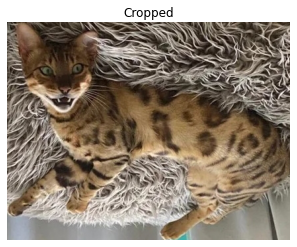

This image most likely belongs to othercats with a 58.58 percent confidence.


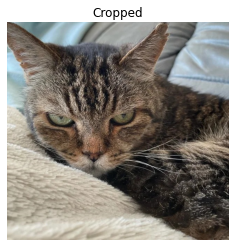

This image most likely belongs to othercats with a 54.51 percent confidence.


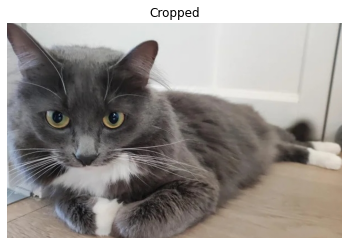

This image most likely belongs to othercats with a 65.65 percent confidence.


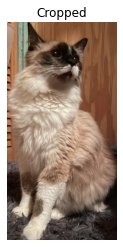

This image most likely belongs to othercats with a 60.62 percent confidence.


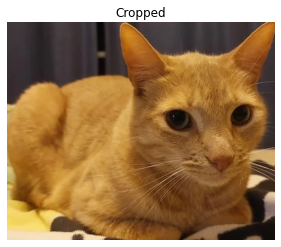

This image most likely belongs to othercats with a 59.64 percent confidence.


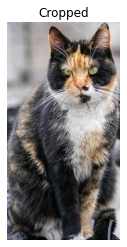

This image most likely belongs to tiny with a 55.16 percent confidence.


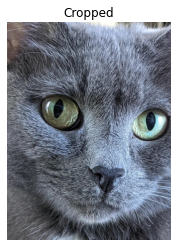

This image most likely belongs to othercats with a 58.79 percent confidence.


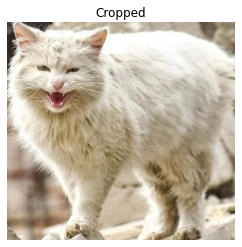

This image most likely belongs to othercats with a 69.06 percent confidence.


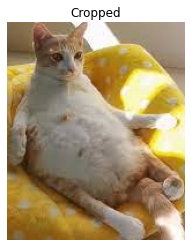

This image most likely belongs to othercats with a 63.14 percent confidence.


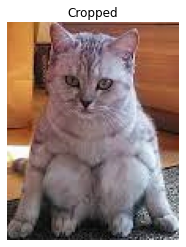

This image most likely belongs to othercats with a 69.19 percent confidence.


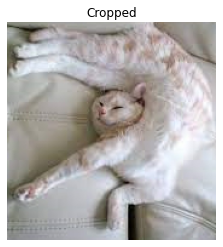

This image most likely belongs to othercats with a 65.36 percent confidence.


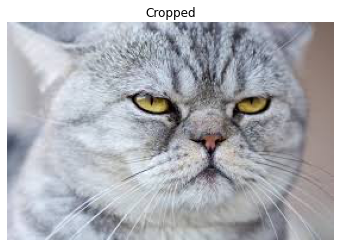

This image most likely belongs to othercats with a 64.07 percent confidence.


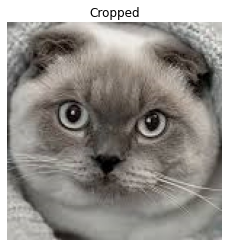

This image most likely belongs to othercats with a 64.15 percent confidence.


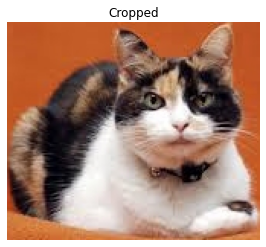

This image most likely belongs to tiny with a 59.75 percent confidence.


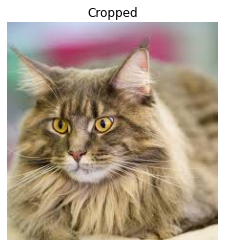

This image most likely belongs to othercats with a 64.04 percent confidence.


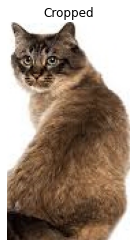

This image most likely belongs to othercats with a 71.95 percent confidence.


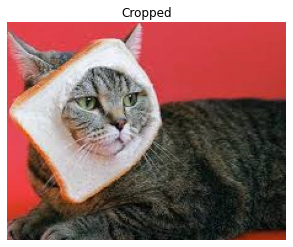

This image most likely belongs to othercats with a 51.10 percent confidence.


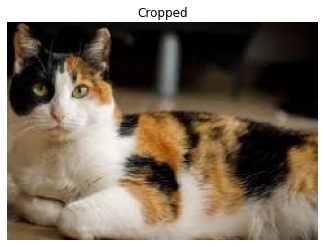

This image most likely belongs to othercats with a 53.75 percent confidence.


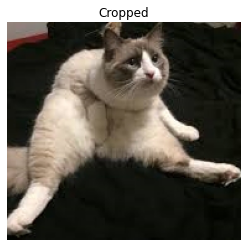

This image most likely belongs to othercats with a 57.92 percent confidence.


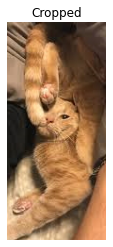

This image most likely belongs to tiny with a 55.28 percent confidence.


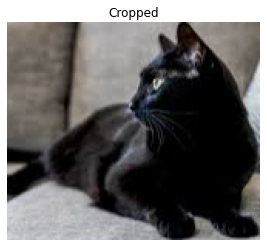

This image most likely belongs to tiny with a 60.03 percent confidence.


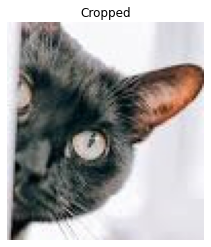

This image most likely belongs to othercats with a 61.62 percent confidence.


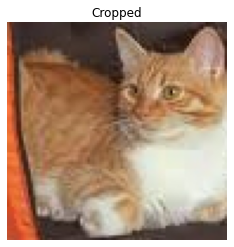

This image most likely belongs to othercats with a 64.06 percent confidence.


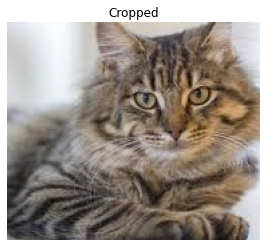

This image most likely belongs to othercats with a 66.47 percent confidence.


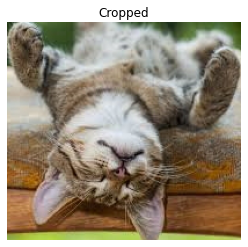

This image most likely belongs to othercats with a 54.12 percent confidence.


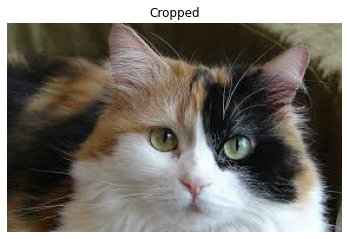

This image most likely belongs to tiny with a 54.60 percent confidence.


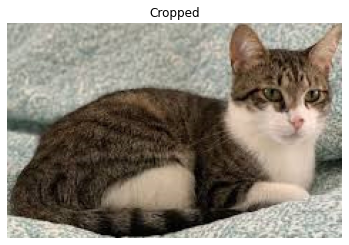

This image most likely belongs to othercats with a 63.86 percent confidence.


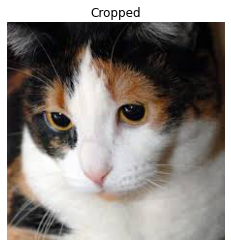

This image most likely belongs to othercats with a 59.81 percent confidence.


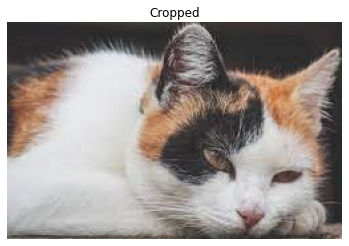

This image most likely belongs to othercats with a 57.03 percent confidence.


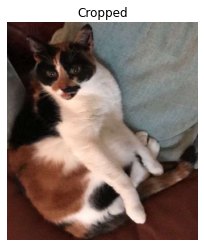

This image most likely belongs to tiny with a 53.88 percent confidence.


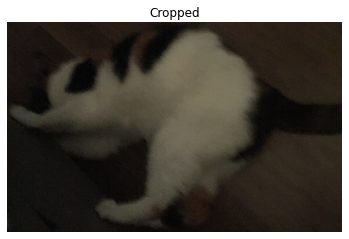

This image most likely belongs to tiny with a 54.11 percent confidence.


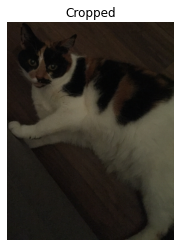

This image most likely belongs to tiny with a 58.54 percent confidence.


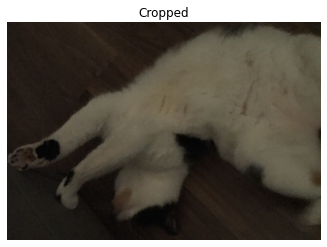

This image most likely belongs to tiny with a 54.48 percent confidence.


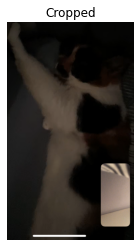

This image most likely belongs to tiny with a 51.93 percent confidence.


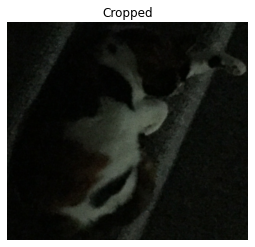

This image most likely belongs to tiny with a 59.14 percent confidence.


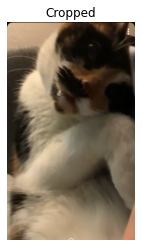

This image most likely belongs to othercats with a 57.35 percent confidence.


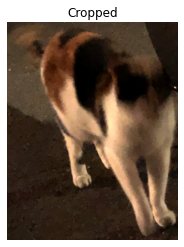

This image most likely belongs to tiny with a 66.59 percent confidence.


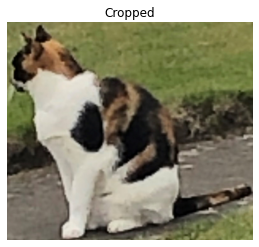

This image most likely belongs to tiny with a 57.64 percent confidence.


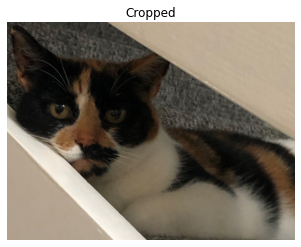

This image most likely belongs to tiny with a 56.20 percent confidence.


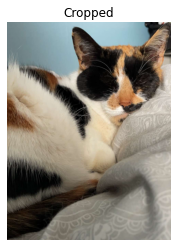

This image most likely belongs to tiny with a 63.01 percent confidence.


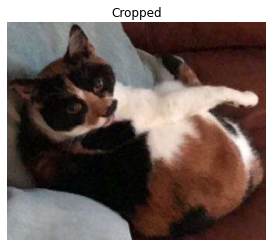

This image most likely belongs to tiny with a 62.60 percent confidence.


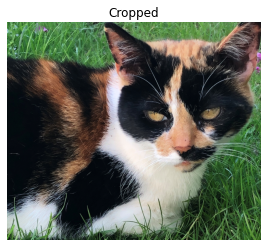

This image most likely belongs to tiny with a 65.03 percent confidence.


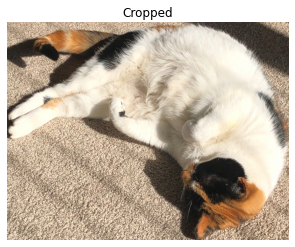

This image most likely belongs to othercats with a 62.97 percent confidence.


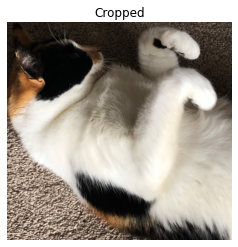

This image most likely belongs to tiny with a 57.61 percent confidence.


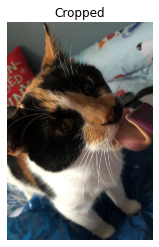

This image most likely belongs to tiny with a 63.77 percent confidence.


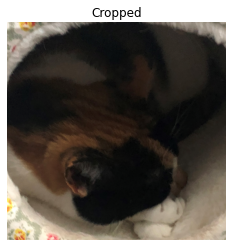

This image most likely belongs to tiny with a 52.33 percent confidence.


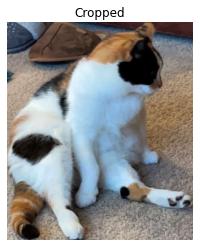

This image most likely belongs to tiny with a 51.84 percent confidence.


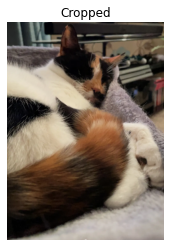

This image most likely belongs to tiny with a 53.69 percent confidence.


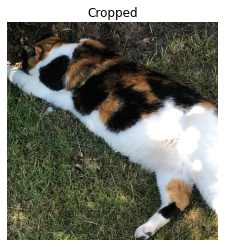

This image most likely belongs to tiny with a 64.90 percent confidence.


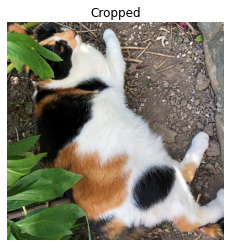

This image most likely belongs to tiny with a 64.58 percent confidence.


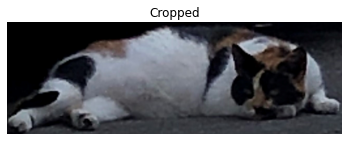

This image most likely belongs to othercats with a 58.80 percent confidence.


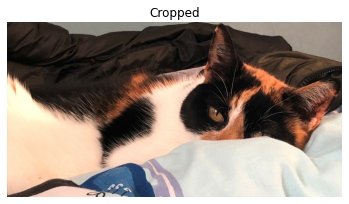

This image most likely belongs to tiny with a 59.22 percent confidence.


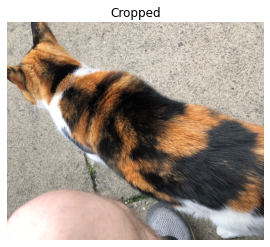

This image most likely belongs to tiny with a 55.86 percent confidence.


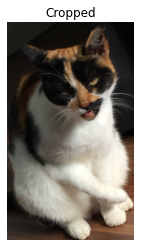

This image most likely belongs to tiny with a 56.18 percent confidence.


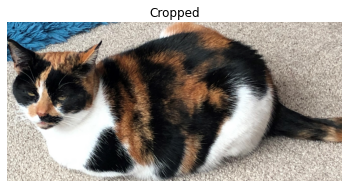

This image most likely belongs to tiny with a 55.15 percent confidence.


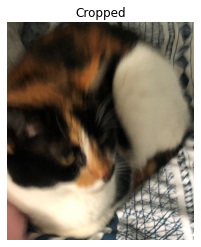

This image most likely belongs to tiny with a 56.92 percent confidence.


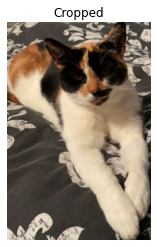

This image most likely belongs to tiny with a 58.07 percent confidence.


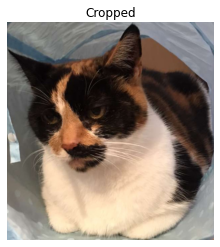

This image most likely belongs to tiny with a 57.63 percent confidence.


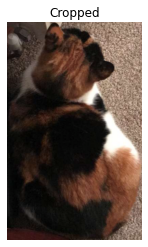

This image most likely belongs to tiny with a 59.56 percent confidence.


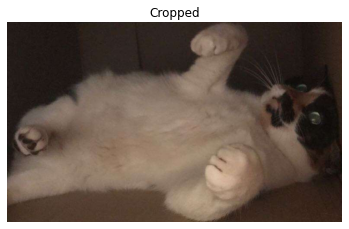

This image most likely belongs to othercats with a 52.68 percent confidence.


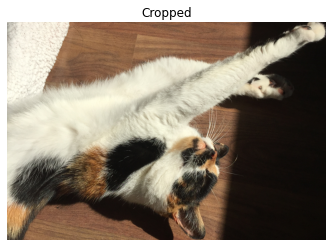

This image most likely belongs to tiny with a 54.40 percent confidence.


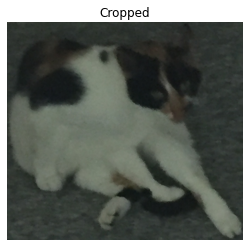

This image most likely belongs to tiny with a 56.13 percent confidence.


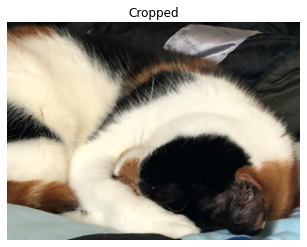

This image most likely belongs to tiny with a 62.18 percent confidence.


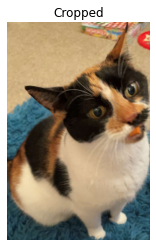

This image most likely belongs to tiny with a 58.47 percent confidence.


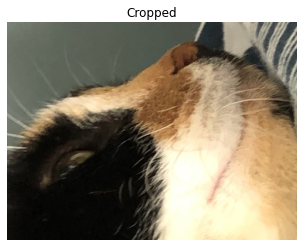

This image most likely belongs to tiny with a 58.55 percent confidence.


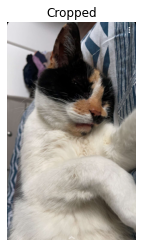

This image most likely belongs to tiny with a 62.13 percent confidence.


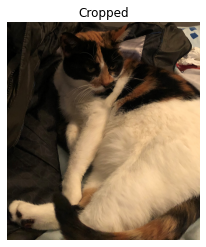

This image most likely belongs to tiny with a 57.51 percent confidence.


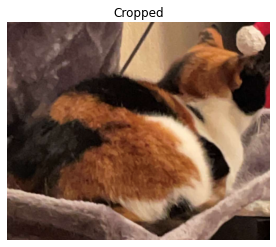

This image most likely belongs to tiny with a 57.57 percent confidence.


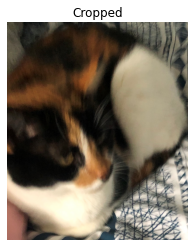

This image most likely belongs to tiny with a 56.88 percent confidence.


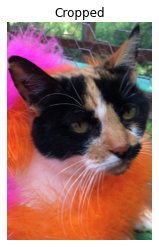

This image most likely belongs to tiny with a 60.44 percent confidence.


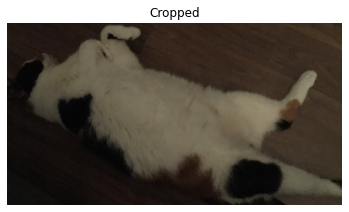

This image most likely belongs to tiny with a 53.79 percent confidence.


In [9]:
#Testing Cropped images

test_location = "C:/Users/maxc2/Desktop/CMP304/Part2 - ML/Assignment/CroppedTest/"
test_path = pathlib.Path(test_location)
files = os.listdir(test_path)

#For each image in the filepath
for file in files:
        # make sure file is an image
        if file.endswith(('.jpg', '.png', 'jpeg')):
            this_test_path = test_location + file
            
            #Create a plot to put image in
            plt.title("Cropped")
            plt.axis("off")

            #Put the selected image into the plot
            image = mpimg.imread(this_test_path)
            plt.imshow(image)
            plt.show()
            
            #Model loading the image
            img = tf.keras.utils.load_img(
                this_test_path, target_size=(img_height, img_width)
            )
            
            #Putting the image into an array
            img_array = tf.keras.utils.img_to_array(img)
            img_array = tf.expand_dims(img_array, 0) # Create a batch

            #Model predicting the image, getting a score
            predictions = model.predict(img_array)
            score = tf.nn.softmax(predictions[0])

            #Printing the models prediction
            print(
                "This image most likely belongs to {} with a {:.2f} percent confidence."
                .format(class_names[np.argmax(score)], 100 * np.max(score))
            )

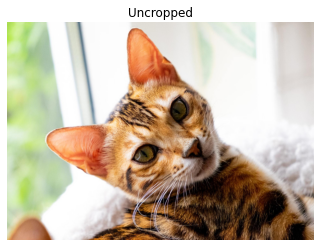

This image most likely belongs to tiny with a 50.48 percent confidence.


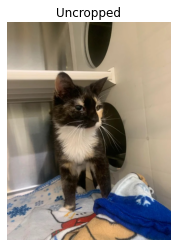

This image most likely belongs to tiny with a 63.87 percent confidence.


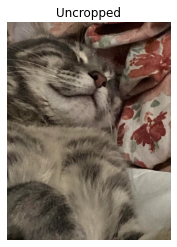

This image most likely belongs to othercats with a 63.26 percent confidence.


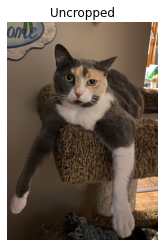

This image most likely belongs to othercats with a 56.43 percent confidence.


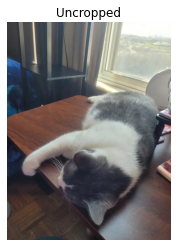

This image most likely belongs to othercats with a 50.20 percent confidence.


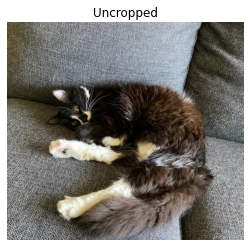

This image most likely belongs to tiny with a 67.59 percent confidence.


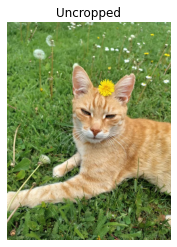

This image most likely belongs to othercats with a 51.51 percent confidence.


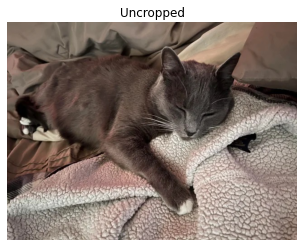

This image most likely belongs to othercats with a 52.70 percent confidence.


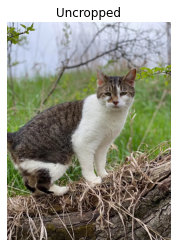

This image most likely belongs to othercats with a 52.84 percent confidence.


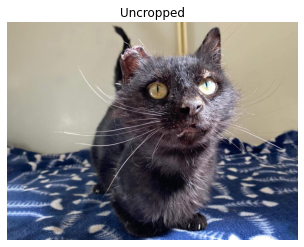

This image most likely belongs to othercats with a 50.67 percent confidence.


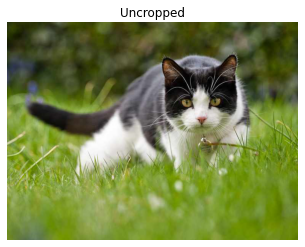

This image most likely belongs to tiny with a 61.48 percent confidence.


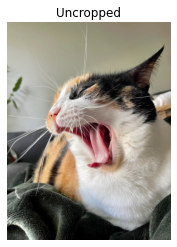

This image most likely belongs to othercats with a 55.68 percent confidence.


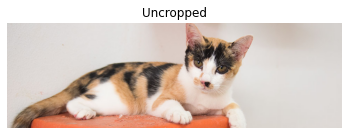

This image most likely belongs to othercats with a 61.96 percent confidence.


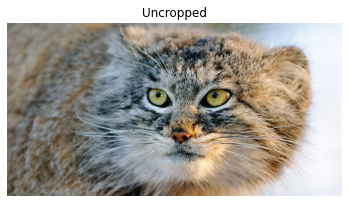

This image most likely belongs to othercats with a 62.50 percent confidence.


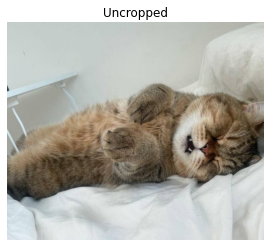

This image most likely belongs to othercats with a 67.08 percent confidence.


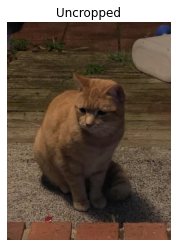

This image most likely belongs to othercats with a 51.30 percent confidence.


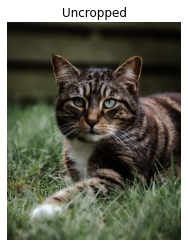

This image most likely belongs to tiny with a 55.44 percent confidence.


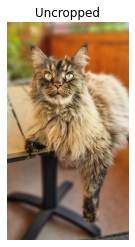

This image most likely belongs to othercats with a 54.97 percent confidence.


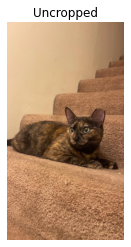

This image most likely belongs to othercats with a 50.24 percent confidence.


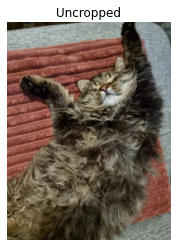

This image most likely belongs to othercats with a 54.13 percent confidence.


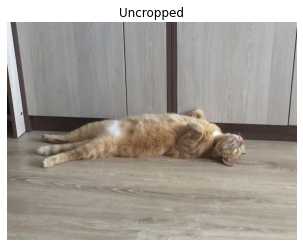

This image most likely belongs to othercats with a 60.96 percent confidence.


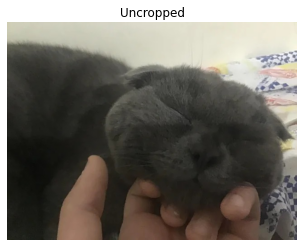

This image most likely belongs to othercats with a 66.51 percent confidence.


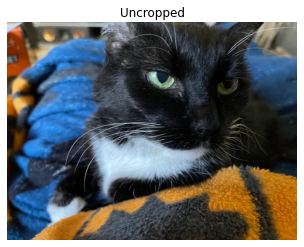

This image most likely belongs to tiny with a 62.74 percent confidence.


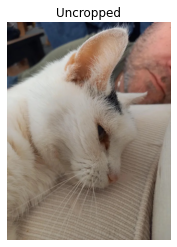

This image most likely belongs to othercats with a 68.69 percent confidence.


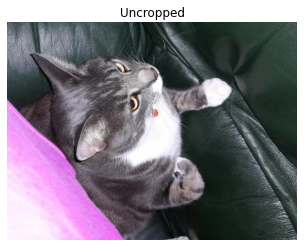

This image most likely belongs to tiny with a 60.97 percent confidence.


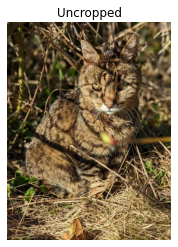

This image most likely belongs to tiny with a 50.40 percent confidence.


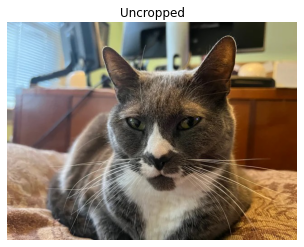

This image most likely belongs to othercats with a 58.29 percent confidence.


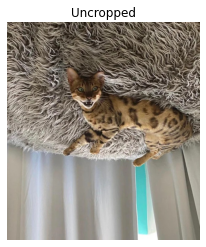

This image most likely belongs to othercats with a 59.91 percent confidence.


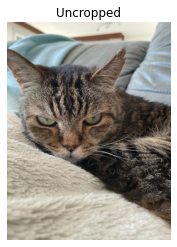

This image most likely belongs to tiny with a 54.24 percent confidence.


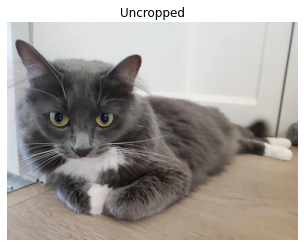

This image most likely belongs to othercats with a 60.32 percent confidence.


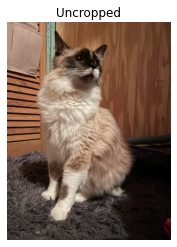

This image most likely belongs to othercats with a 51.90 percent confidence.


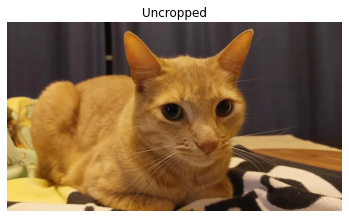

This image most likely belongs to othercats with a 55.21 percent confidence.


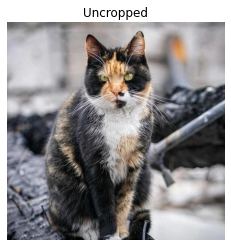

This image most likely belongs to tiny with a 51.35 percent confidence.


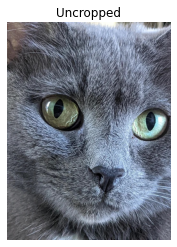

This image most likely belongs to othercats with a 52.64 percent confidence.


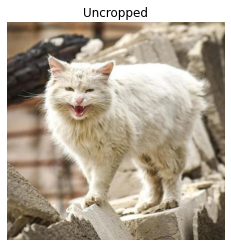

This image most likely belongs to othercats with a 64.72 percent confidence.


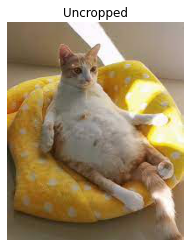

This image most likely belongs to othercats with a 59.88 percent confidence.


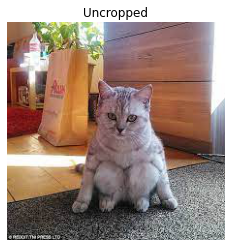

This image most likely belongs to othercats with a 54.77 percent confidence.


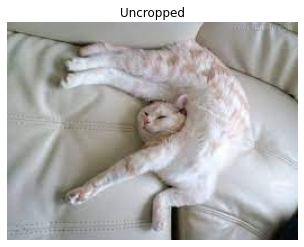

This image most likely belongs to othercats with a 63.87 percent confidence.


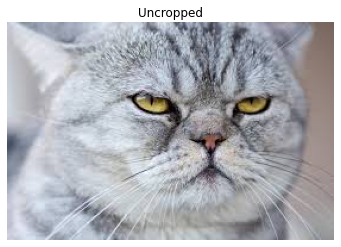

This image most likely belongs to othercats with a 62.39 percent confidence.


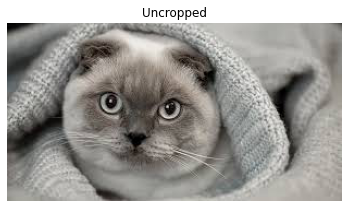

This image most likely belongs to othercats with a 63.00 percent confidence.


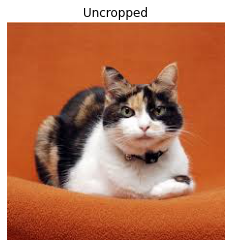

This image most likely belongs to tiny with a 63.60 percent confidence.


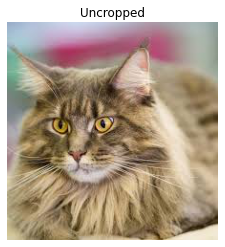

This image most likely belongs to othercats with a 63.04 percent confidence.


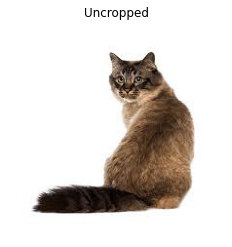

This image most likely belongs to othercats with a 54.55 percent confidence.


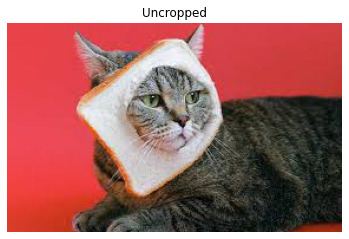

This image most likely belongs to othercats with a 52.50 percent confidence.


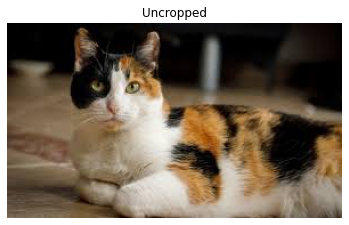

This image most likely belongs to othercats with a 61.40 percent confidence.


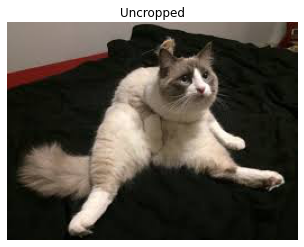

This image most likely belongs to tiny with a 51.95 percent confidence.


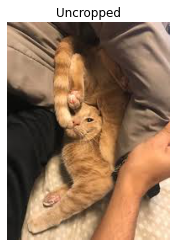

This image most likely belongs to othercats with a 58.01 percent confidence.


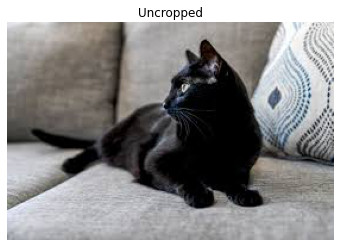

This image most likely belongs to tiny with a 69.79 percent confidence.


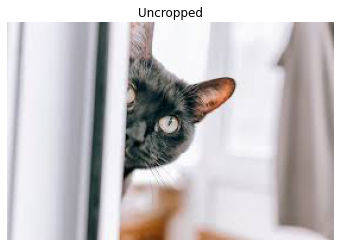

This image most likely belongs to othercats with a 57.18 percent confidence.


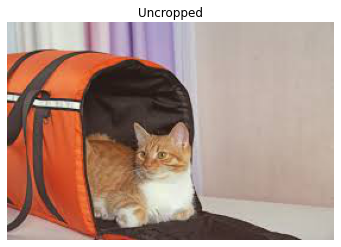

This image most likely belongs to othercats with a 52.69 percent confidence.


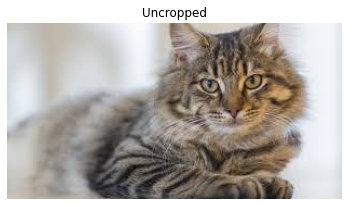

This image most likely belongs to othercats with a 65.73 percent confidence.


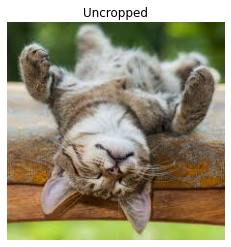

This image most likely belongs to othercats with a 56.33 percent confidence.


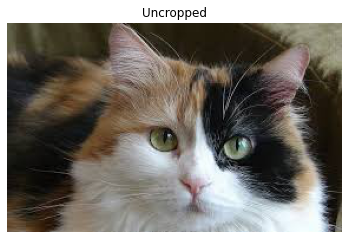

This image most likely belongs to tiny with a 51.80 percent confidence.


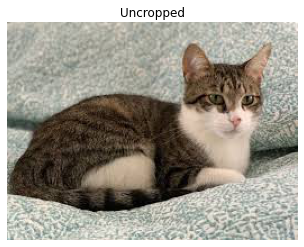

This image most likely belongs to othercats with a 53.31 percent confidence.


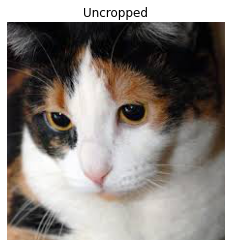

This image most likely belongs to othercats with a 60.32 percent confidence.


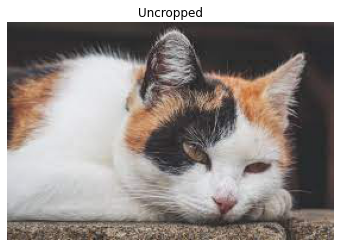

This image most likely belongs to othercats with a 51.39 percent confidence.


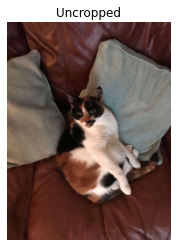

This image most likely belongs to tiny with a 66.40 percent confidence.


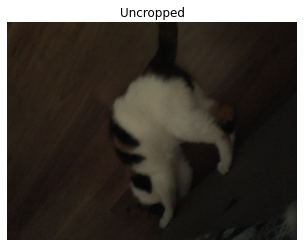

This image most likely belongs to tiny with a 57.51 percent confidence.


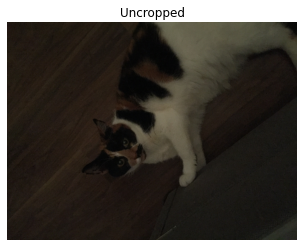

This image most likely belongs to tiny with a 60.69 percent confidence.


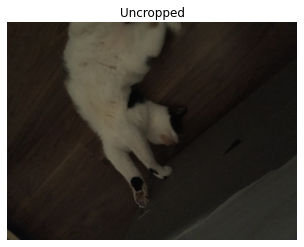

This image most likely belongs to tiny with a 54.77 percent confidence.


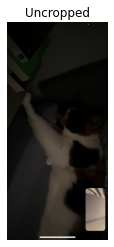

This image most likely belongs to tiny with a 64.27 percent confidence.


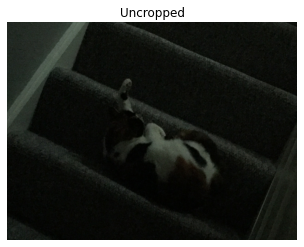

This image most likely belongs to tiny with a 61.23 percent confidence.


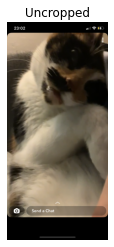

This image most likely belongs to othercats with a 72.86 percent confidence.


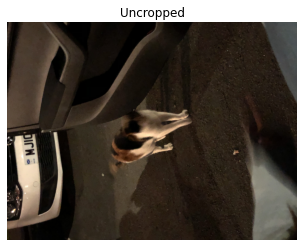

This image most likely belongs to othercats with a 51.69 percent confidence.


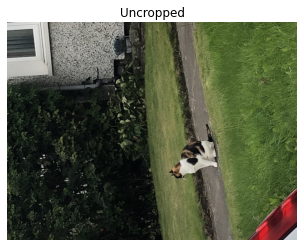

This image most likely belongs to tiny with a 52.62 percent confidence.


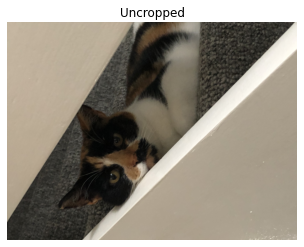

This image most likely belongs to tiny with a 55.13 percent confidence.


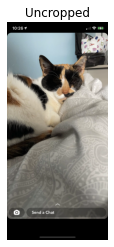

This image most likely belongs to othercats with a 70.44 percent confidence.


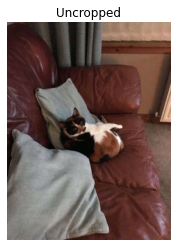

This image most likely belongs to tiny with a 57.65 percent confidence.


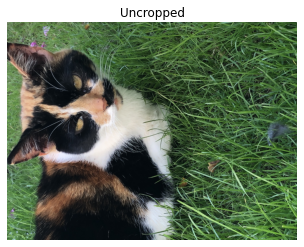

This image most likely belongs to tiny with a 64.01 percent confidence.


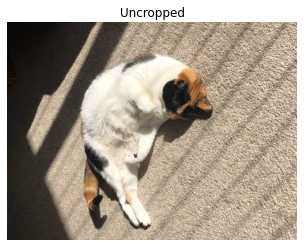

This image most likely belongs to tiny with a 50.21 percent confidence.


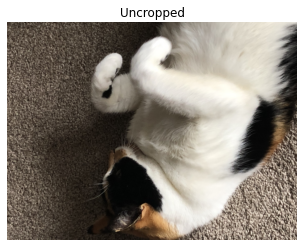

This image most likely belongs to othercats with a 50.92 percent confidence.


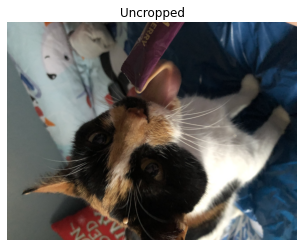

This image most likely belongs to tiny with a 66.74 percent confidence.


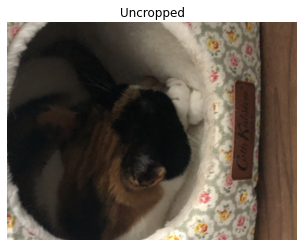

This image most likely belongs to tiny with a 53.85 percent confidence.


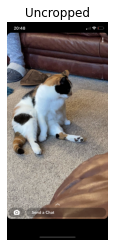

This image most likely belongs to othercats with a 72.48 percent confidence.


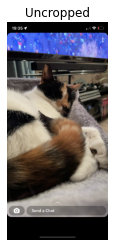

This image most likely belongs to othercats with a 66.45 percent confidence.


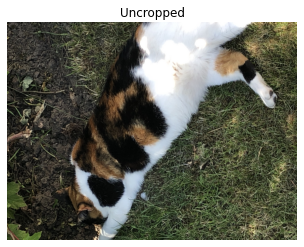

This image most likely belongs to tiny with a 63.72 percent confidence.


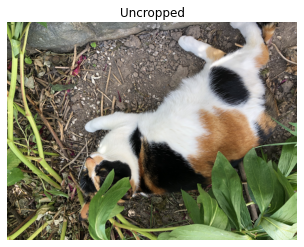

This image most likely belongs to tiny with a 66.63 percent confidence.


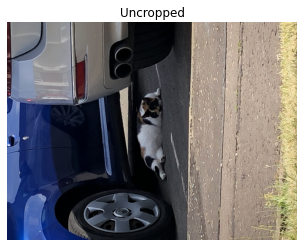

This image most likely belongs to tiny with a 62.14 percent confidence.


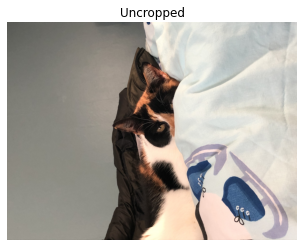

This image most likely belongs to tiny with a 53.60 percent confidence.


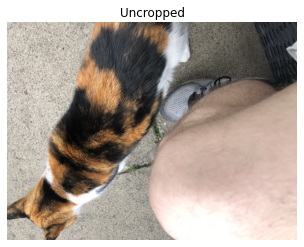

This image most likely belongs to tiny with a 52.65 percent confidence.


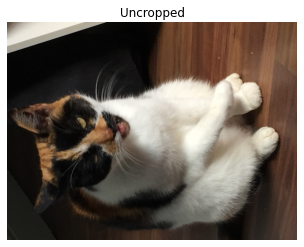

This image most likely belongs to tiny with a 52.36 percent confidence.


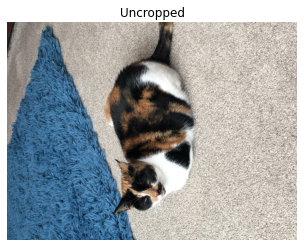

This image most likely belongs to tiny with a 53.23 percent confidence.


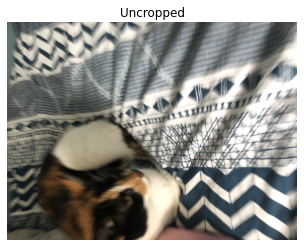

This image most likely belongs to othercats with a 52.24 percent confidence.


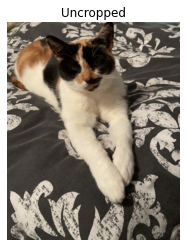

This image most likely belongs to tiny with a 52.95 percent confidence.


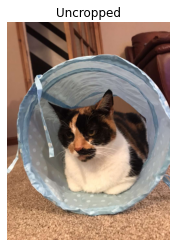

This image most likely belongs to tiny with a 53.07 percent confidence.


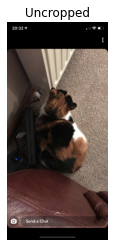

This image most likely belongs to othercats with a 72.81 percent confidence.


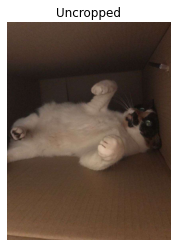

This image most likely belongs to tiny with a 54.18 percent confidence.


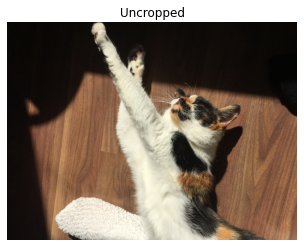

This image most likely belongs to othercats with a 63.86 percent confidence.


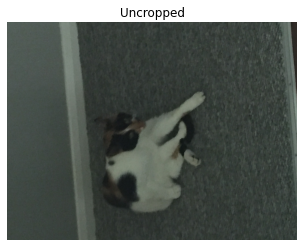

This image most likely belongs to tiny with a 50.04 percent confidence.


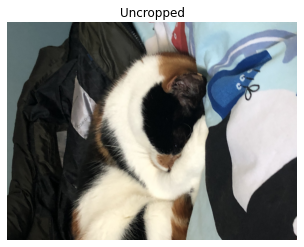

This image most likely belongs to tiny with a 61.54 percent confidence.


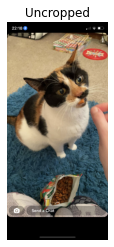

This image most likely belongs to othercats with a 56.20 percent confidence.


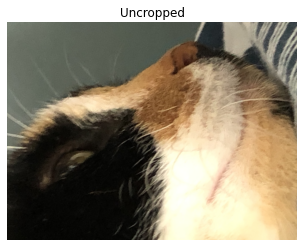

This image most likely belongs to othercats with a 52.65 percent confidence.


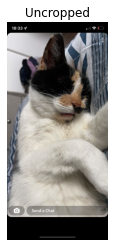

This image most likely belongs to othercats with a 61.06 percent confidence.


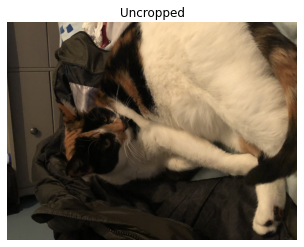

This image most likely belongs to tiny with a 60.48 percent confidence.


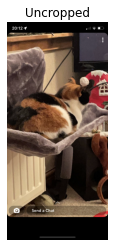

This image most likely belongs to tiny with a 52.66 percent confidence.


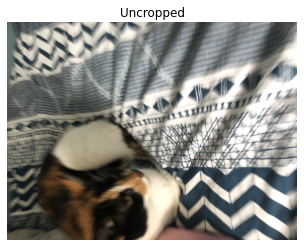

This image most likely belongs to othercats with a 52.24 percent confidence.


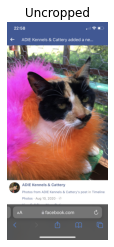

This image most likely belongs to tiny with a 68.07 percent confidence.


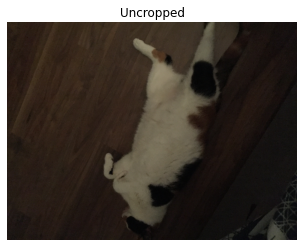

This image most likely belongs to tiny with a 55.88 percent confidence.


In [10]:
#Testing uncropped images
test_location = "C:/Users/maxc2/Desktop/CMP304/Part2 - ML/Assignment/UncroppedTest/"
test_path = pathlib.Path(test_location)
files = os.listdir(test_path)

for file in files:
        # make sure file is an image
        if file.endswith(('.jpg', '.png', 'jpeg')):
            this_test_path = test_location + file
            
            plt.title("Uncropped")
            plt.axis("off")

            image = mpimg.imread(this_test_path)
            plt.imshow(image)
            plt.show()
            
            img = tf.keras.utils.load_img(
                this_test_path, target_size=(img_height, img_width)
            )
            img_array = tf.keras.utils.img_to_array(img)
            img_array = tf.expand_dims(img_array, 0) # Create a batch

            predictions = model.predict(img_array)
            score = tf.nn.softmax(predictions[0])

            print(
                "This image most likely belongs to {} with a {:.2f} percent confidence."
                .format(class_names[np.argmax(score)], 100 * np.max(score))
            )